# SF - Streets + Muni stops
This project was an opportunity to utilise a SFMTA GTFS data and shapefiles from data.sfgov.org. The aim of this project was to explore the coverage of Muni stops in San Francisco based on research suggesting that people are generally willing to walk longer than what has become the adopted standard of 400m. The paper suggests that a distance closer to 524m is more appropriate.

Note that this measure is not universal and that a good number of other factors including the weather, condition and availability of sidewalk, reliability and frequency of transit service, distance to be travelled, all contribute to how much a person is willing to walk to a transit stop.

data sources: 

* Street shapefile --> https://data.sfgov.org/Geographic-Locations-and-Boundaries/San-Francisco-Basemap-Street-Centerlines/7hfy-8sz8
* Muni stops --> SFMTA GTFS

## Relevant Libraries

In [1]:
%matplotlib inline

import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
import palettable as pltt
from seaborn import palplot
import seaborn as sns
from shapely.geometry import Point
import mplleaflet

## Load in Data

In [2]:
# directory
bs_dir = "San Francisco Basemap Street Centerlines/"
# the shapefile for San Francisco streets
baseline_streets_link = "geo_export_0274863a-ce2d-4ea1-953d-d8abb0efac14.shp"
baseline_streets = gpd.read_file(bs_dir + baseline_streets_link)
baseline_streets.head()

,accepted,classcode,cnn,cnntext,district,f_node_cnn,jurisdicti,layer,lf_fadd,lf_toadd,...,oneway,rt_fadd,rt_toadd,st_type,street,street_gc,streetname,t_node_cnn,zip_code,geometry
0,N,0,15145000.0,15145000,,26132000.0,,PRIVATE,0.0,0.0,...,B,0.0,0.0,CT,CROWN,CROWN,CROWN CT,54223000.0,94114,LINESTRING (-122.4469424451799 37.757228921523...
1,Y,0,11305001.0,11305001,,26255000.0,DPW,UPROW,1.0,37.0,...,B,2.0,36.0,AVE,SAINT GERMAIN,SAINT GERMAIN,SAINT GERMAIN AVE,54224000.0,94114,LINESTRING (-122.4479152656158 37.757589498018...
2,Y,5,11305002.0,11305002,,54224000.0,DPW,STREETS,39.0,99.0,...,B,38.0,98.0,AVE,SAINT GERMAIN,SAINT GERMAIN,SAINT GERMAIN AVE,26247000.0,94114,LINESTRING (-122.4488770135246 37.757536327477...
3,Y,5,13798000.0,13798000,,35015000.0,DPW,STREETS,221.0,299.0,...,F,222.0,298.0,ST,CORONA,CORONA,CORONA ST,35015000.0,94127,LINESTRING (-122.4665977274102 37.725924475312...
4,N,5,5389001.0,5389001,,35016000.0,DPW,STREETS,1001.0,1099.0,...,B,1000.0,1098.0,AVE,FAIRFAX,FAIRFAX,FAIRFAX AVE,35017000.0,94124,LINESTRING (-122.3808508035504 37.736279384703...


In [3]:
# SFMTA GTFS stops data
stops = pd.read_csv('stops.txt', sep=",", header=0)
stops.head()

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url
0,390,10390,19th Avenue & Holloway St,,37.721190,-122.475096,,
1,913,10913,DUBLIN ST & LAGRANDE AVE,,37.719192,-122.425802,,
2,3003,13003,2nd St & Brannan St,,37.781827,-122.391945,,
3,3004,13004,2nd St & Brannan St,,37.781854,-122.392232,,
4,3009,13009,2nd St & Harrison St,,37.784532,-122.395325,,


## Preliminary Street Visualisations

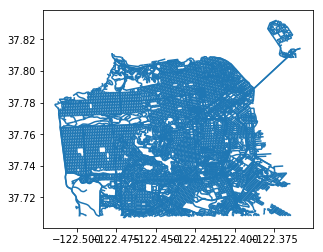

In [4]:
# plotting the streets of San Francisco
baseline_streets.plot()

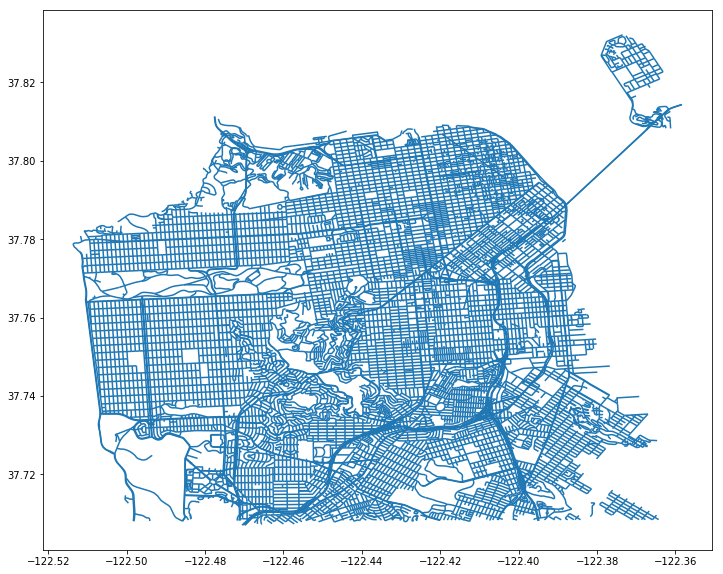

In [5]:
# plotting the streets of San Francisco but larger
f, ax = plt.subplots(1, figsize=(12, 12))
ax = baseline_streets.plot(ax=ax)

## Data Cleaning

### GTFS data converted into geopandas points

In [6]:
# zip the longitude and latitude data together to form a combined coordinates
stops['Coordinates'] = list(zip(stops.stop_lon, stops.stop_lat))

# use shapely to turn coordinates into Points
stops['Coordinates'] = stops['Coordinates'].apply(Point)

# convert the pandas dataframe into a geopandas dataframe
stops_gdf = gpd.GeoDataFrame(stops, geometry='Coordinates')
stops_gdf.head()

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,Coordinates
0,390,10390,19th Avenue & Holloway St,,37.721190,-122.475096,,,POINT (-122.475096 37.72119)
1,913,10913,DUBLIN ST & LAGRANDE AVE,,37.719192,-122.425802,,,POINT (-122.425802 37.719192)
2,3003,13003,2nd St & Brannan St,,37.781827,-122.391945,,,POINT (-122.391945 37.781827)
3,3004,13004,2nd St & Brannan St,,37.781854,-122.392232,,,POINT (-122.392232 37.781854)
4,3009,13009,2nd St & Harrison St,,37.784532,-122.395325,,,POINT (-122.395325 37.784532)


## Preliminary Muni Stops Visualisations

In [7]:
# assign the crs of the data
stops_gdf.crs = {'init' :'epsg:4326'}
# convert it to epsg3174 that measures in meters
stops_gdf = stops_gdf.to_crs({'init': 'epsg:3174'}) 
stops_gdf.head()

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,Coordinates
0,390,10390,19th Avenue & Holloway St,,37.721190,-122.475096,,,POINT (-2249913.667659364 912616.9315020253)
1,913,10913,DUBLIN ST & LAGRANDE AVE,,37.719192,-122.425802,,,POINT (-2246118.612584498 910428.9080820472)
2,3003,13003,2nd St & Brannan St,,37.781827,-122.391945,,,POINT (-2240302.610255989 915213.3662177322)
3,3004,13004,2nd St & Brannan St,,37.781854,-122.392232,,,POINT (-2240323.923023472 915227.5876938032)
4,3009,13009,2nd St & Harrison St,,37.784532,-122.395325,,,POINT (-2240433.931482567 915615.2912387213)


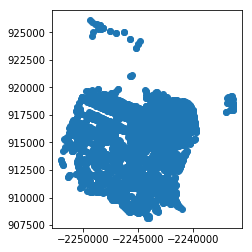

In [8]:
stops_gdf.plot()

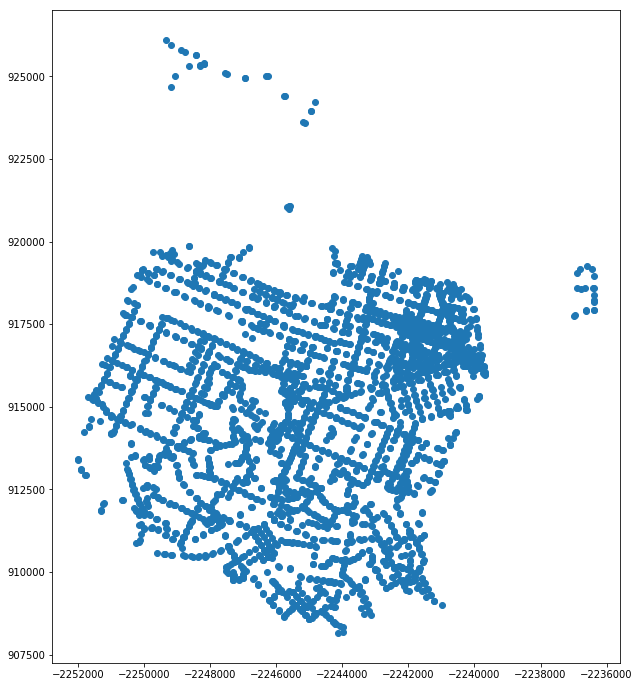

In [9]:
# plotting the Muni stops of San Francisco but larger
f, ax = plt.subplots(1, figsize=(12, 12))
ax = stops_gdf.plot(ax=ax)

## Adding Colour

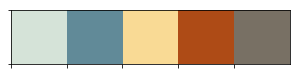

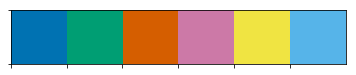

In [10]:
# wes anderson colour palette
wes = pltt.wesanderson.Darjeeling2_5.hex_colors
palplot(wes)

# colourblind colour palette - the colour palette itself is not colourblind :P
colorblind = sns.color_palette("colorblind")
palplot(colorblind)

In [11]:
wes

['#D5E3D8', '#618A98', '#F9DA95', '#AE4B16', '#787064']

In [12]:
colorblind.as_hex()

['#0072b2', '#009e73', '#d55e00', '#cc79a7', '#f0e442', '#56b4e9']

## Creating Buffers around Muni Stops

The 85th percentile walking distance to bus transit service is around 524 m from
home-based trip origins, 1,259 m for commuter rail. This finding raises the importance of
careful revision of the 400- and 800-m service area rules used in the transit industry.
(El-Geneidy, Grimsrud, Wasfi, Tétreault & Surprenant-Legault, 2013)

Below I compare the 400m buffer zone against the suggested 524m buffer zone:

### 400m air-distance buffer zone

In [13]:
# 200 here is in meters and represents the radius length
buf_400 = stops_gdf.buffer(400)
# convert it back to epsg4326 to be in line with the streets
buf_400 = buf_400.to_crs({'init': 'epsg:4326'}) 
buf_400.head()

0    POLYGON ((-122.4710838510035 37.72284266054291...
1    POLYGON ((-122.4217887166728 37.72084268674859...
2    POLYGON ((-122.387926963637 37.78347610097564,...
3    POLYGON ((-122.3882139692808 37.7835031124156,...
4    POLYGON ((-122.3913068817127 37.78618122716293...
dtype: object

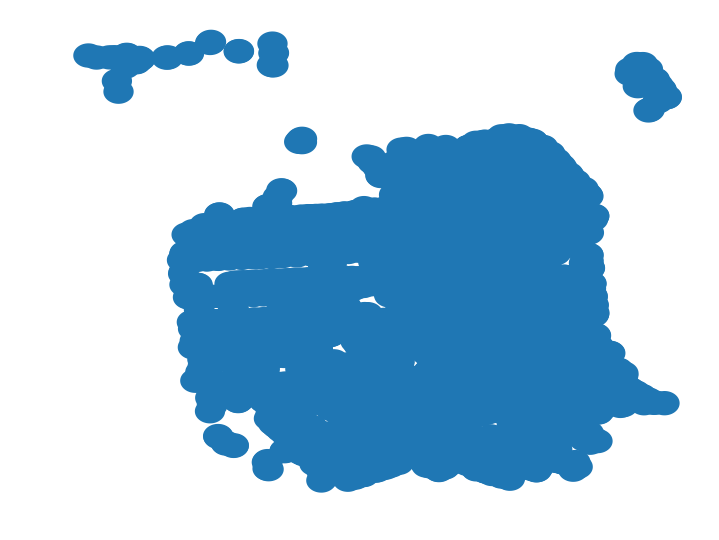

In [14]:
f, ax = plt.subplots(1, figsize=(12, 12))
ax = buf_400.plot(ax=ax)
ax.set_axis_off()

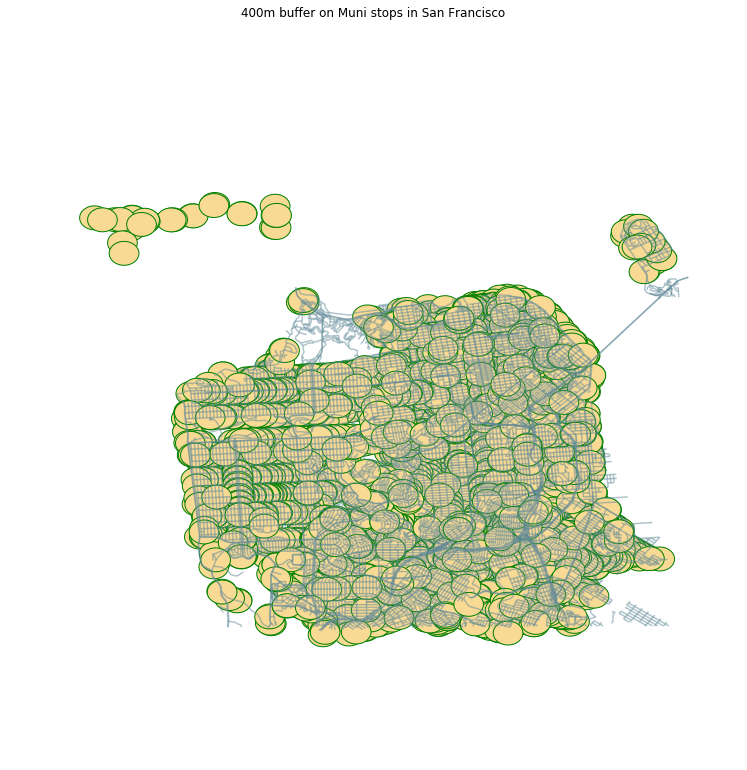

In [15]:
f, ax = plt.subplots(1, figsize=(12, 12))
baseline_streets.plot(ax=ax, color='#618A98', alpha=0.5)
buf_400.plot(ax=ax, color = '#F9DA95', edgecolor='green')

f.suptitle('400m buffer on Muni stops in San Francisco')
ax.set_axis_off()
plt.axis('equal')
plt.show()

### 524m air-distance buffer zone

In [16]:
# 262 here is in meters and represents the radius length
buf_524 = stops_gdf.buffer(524)
# convert it back to epsg4326 to be in line with the streets
buf_524 = buf_524.to_crs({'init': 'epsg:4326'}) 
buf_524.head()

0    POLYGON ((-122.4698400431987 37.72335495136704...
1    POLYGON ((-122.4205445572649 37.72135436567951...
2    POLYGON ((-122.3866813307327 37.7839872882852,...
3    POLYGON ((-122.3869683381259 37.78401430327159...
4    POLYGON ((-122.3900612234059 37.78669245359092...
dtype: object

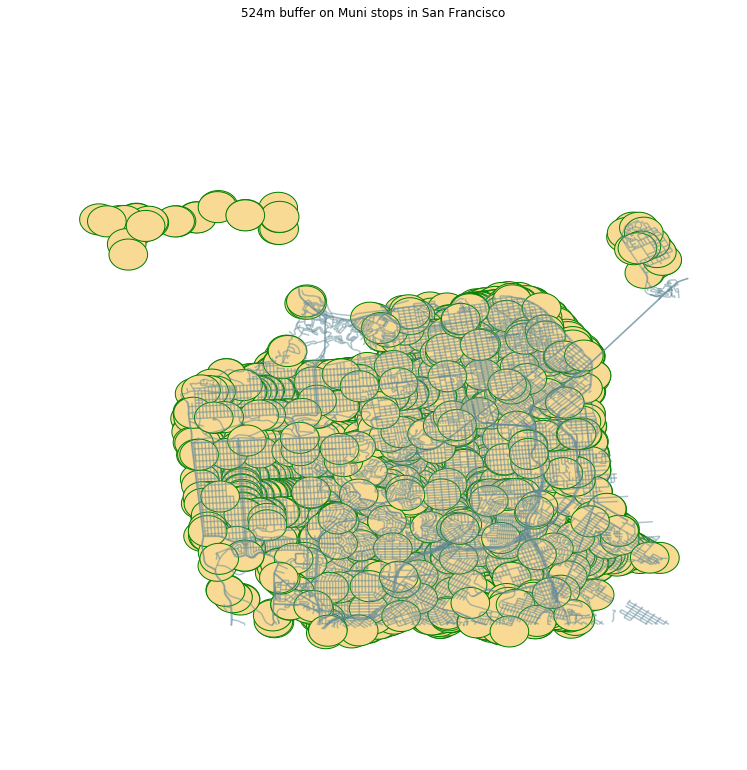

In [17]:
f, ax = plt.subplots(1, figsize=(12, 12))
baseline_streets.plot(ax=ax, color='#618A98', alpha=0.5)
buf_524.plot(ax=ax, color = '#F9DA95', edgecolor='green')

f.suptitle('524m buffer on Muni stops in San Francisco')
ax.set_axis_off()
plt.axis('equal')
plt.show()

## Overlaying on an Interactive Map

In [18]:
f, ax = plt.subplots(1)
ax = baseline_streets.plot(ax=ax, color='#618A98', alpha=1)
ax = buf_524.plot(ax=ax, color = '#F9DA95', edgecolor='green')
# displays the interactive map in the notebook
mplleaflet.display(fig=f, crs=baseline_streets.crs)

In [19]:
# displays the interactive map in browser as html
mplleaflet.show(fig=f, crs=baseline_streets.crs)

## Side-by-side Comparison

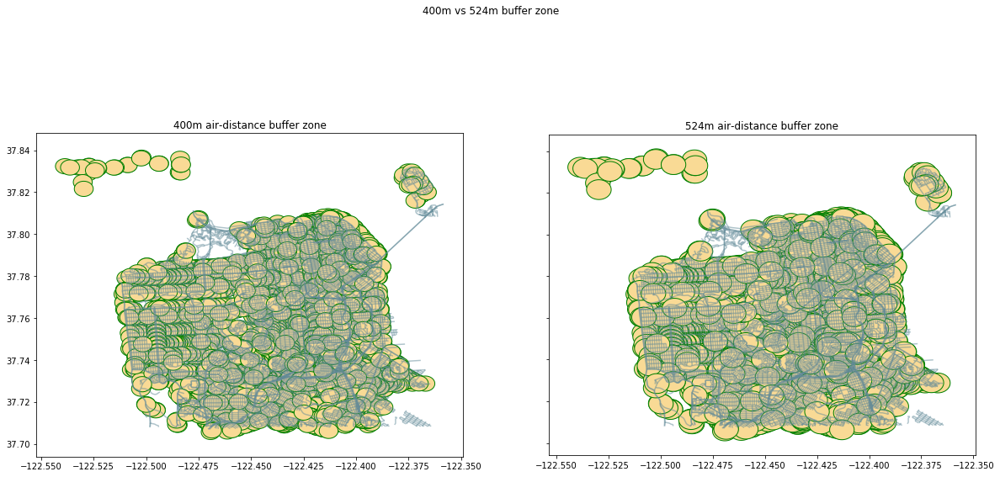

In [20]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10), sharey=True)
f.suptitle('400m vs 524m buffer zone')

ax1 =  baseline_streets.plot(ax=ax1, color='#618A98', alpha=0.5)
ax1 =  buf_400.plot(ax=ax1, color = '#F9DA95', edgecolor='green')
ax1.set_title("400m air-distance buffer zone")

ax2 =  baseline_streets.plot(ax=ax2, color='#618A98', alpha=0.5)
ax2 =  buf_524.plot(ax=ax2, color = '#F9DA95', edgecolor='green')
ax2.set_title("524m air-distance buffer zone")

plt.show()

## Conclusion

San Francisco is well covered in terms of Muni stops. Even with a buffer of 400m, there are only tiny areas that do not fall into these coverage areas. As noted above however, there are a few considerations to take into account. First of which is that San Francisco is naturally hilly and 400m or 524m is a distance that requires considerably more effort going uphill. Additionally, the buffer zone calculated here is of air distance and not walking distance. An air distance of 400m is almost always going to account for a higher coverage area than a 400 walking distance.

## Extensions + Small Project Ideas
* There appears to be an overlay of Muni stops on top of one another - not short stop distances that intersect but actually over each other. Worth exploring the GTFS data again to figure out why that is the case.
* Using buffer is an easy way of calculating service area but there is significant and critical literature out there focused on walking distance over air-distance.
* Explore service routes instead of service stops to study how connected San Francisco is and how easy it is to travel between neighbourhoods.
* Explore and delineate service providers or mode of transport to identify how the service providers compete or complement each other.

## References

* El-Geneidy, A., Grimsrud, M., Wasfi, R., Tétreault, P., & Surprenant-Legault, J. (2013). New evidence on walking distances to transit stops: identifying redundancies and gaps using variable service areas. Transportation, 41(1), 193-210. doi: 10.1007/s11116-013-9508-z